In [1]:
import os
import time
import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from torch import optim
import torchvision
from torchvision import transforms
from torchvision.transforms.functional import to_pil_image
from PIL import Image, ImageOps
from collections import OrderedDict, defaultdict, Counter
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from matplotlib.gridspec import GridSpec
import numpy as np
from pathlib import Path

/home/antonello03/anaconda3/envs/py31/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
model_dir  = "/home/antonello03/gdrive/Colab Notebooks/UNI/ProjectWork/"
image_path = Path('styles/out')

In [3]:
top4styles = ['Impressionism', 'Realism', 'Baroque', 'Romanticism']
root = Path('styles/out')

styles_images = {
    style: [Image.open(p) for p in sorted(root.glob(f'{style}_*.jpg'),
                                          key=lambda q: int(q.stem.split('_')[1]))[:6]]
    for style in top4styles
}

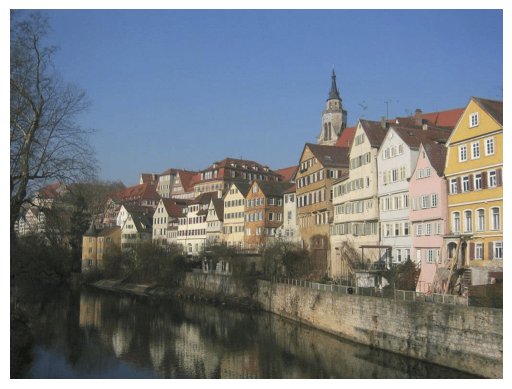

In [4]:
contentPicture= Path('Tuebingens.jpg')
plt.imshow(Image.open(contentPicture))
plt.axis('off')
plt.show()

# Model Definition

In [5]:
#vgg definition that conveniently let's you grab the outputs from any layer
class VGG(nn.Module):
    def __init__(self, pool='avg'):
        super(VGG, self).__init__()
        #vgg modules
        self.conv1_1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_4 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        if pool == 'max':
            self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)
        elif pool == 'avg':
            self.pool1 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.AvgPool2d(kernel_size=2, stride=2)

    def forward(self, x, out_keys):
        out = {}
        out['r11'] = F.relu(self.conv1_1(x))
        out['r12'] = F.relu(self.conv1_2(out['r11']))
        out['p1'] = self.pool1(out['r12'])
        out['r21'] = F.relu(self.conv2_1(out['p1']))
        out['r22'] = F.relu(self.conv2_2(out['r21']))
        out['p2'] = self.pool2(out['r22'])
        out['r31'] = F.relu(self.conv3_1(out['p2']))
        out['r32'] = F.relu(self.conv3_2(out['r31']))
        out['r33'] = F.relu(self.conv3_3(out['r32']))
        out['r34'] = F.relu(self.conv3_4(out['r33']))
        out['p3'] = self.pool3(out['r34'])
        out['r41'] = F.relu(self.conv4_1(out['p3']))
        out['r42'] = F.relu(self.conv4_2(out['r41']))
        out['r43'] = F.relu(self.conv4_3(out['r42']))
        out['r44'] = F.relu(self.conv4_4(out['r43']))
        out['p4'] = self.pool4(out['r44'])
        out['r51'] = F.relu(self.conv5_1(out['p4']))
        out['r52'] = F.relu(self.conv5_2(out['r51']))
        out['r53'] = F.relu(self.conv5_3(out['r52']))
        out['r54'] = F.relu(self.conv5_4(out['r53']))
        out['p5'] = self.pool5(out['r54'])
        return [out[key] for key in out_keys]

# gram matrix and loss
class GramMatrix(nn.Module):
    def forward(self, input):
        b,c,h,w = input.size()
        F = input.view(b, c, h*w)
        G = torch.bmm(F, F.transpose(1,2))
        G.div_(h*w)
        return G

class GramMSELoss(nn.Module):
    def forward(self, input, target):
        out = nn.MSELoss()(GramMatrix()(input), target)
        return(out)
    
# pearson correlation loss
class PearsonCorrelationLoss(nn.Module):
    def forward(self, x, y):
        """
        Pearson correlation loss.
        """
        
        x_gram = GramMatrix()(x)

        x_flat = x_gram.view(-1).float()
        y_flat = y.view(-1).float()

        mean_x = torch.mean(x_flat)
        mean_y = torch.mean(y_flat)

        xm = x_flat - mean_x
        ym = y_flat - mean_y

        numer = torch.dot(xm, ym)
        denom = torch.sqrt(torch.dot(xm, xm) * torch.dot(ym, ym))
        eps = 1e-8
        r = numer / (denom + eps)
        distance = 1.0 - r
        return (distance)

# Cosine similarity loss
class CosineSimilarityLoss(nn.Module):
    def forward(self, x, y):
        """
        Cosine similarity loss.
        """
        x_gram = GramMatrix()(x)

        x_flat = x_gram.view(-1).float()
        y_flat = y.view(-1).float()
        # Dot‐product
        dot_xy = torch.dot(x_flat, y_flat)
        # Norme L2
        norm_x = torch.norm(x_flat, p=2)
        norm_y = torch.norm(y_flat, p=2)
        eps = 1e-8
        cos_sim = dot_xy / (norm_x * norm_y + eps)
        return (1.0 - cos_sim)

# pre and post processing for images
img_size = 512
prep = transforms.Compose([transforms.Resize(img_size),
                           transforms.ToTensor(),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to BGR
                           transforms.Normalize(mean=[0.40760392, 0.45795686, 0.48501961], #subtract imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x.mul_(255)),
                          ])
postpa = transforms.Compose([transforms.Lambda(lambda x: x.mul_(1./255)),
                           transforms.Normalize(mean=[-0.40760392, -0.45795686, -0.48501961], #add imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to RGB
                           ])
postpb = transforms.Compose([transforms.ToPILImage()])
def postp(tensor): # to clip results in the range [0,1]
    t = postpa(tensor)
    t[t>1] = 1
    t[t<0] = 0
    img = postpb(t)
    return img

In [6]:
vgg = VGG()
vgg.load_state_dict(torch.load(model_dir + 'vgg_conv.pth'))

for param in vgg.parameters():
    param.requires_grad = False
if torch.cuda.is_available():
    vgg.cuda()

# Preparing Images

In [39]:
#load images, ordered as [style_image, content_image]
img_dirs = [str(image_path)+"/", "./"]
img_names = ['Impressionism_0.jpg', 'Tuebingens.jpg']
imgs = [Image.open(img_dirs[i] + name) for i,name in enumerate(img_names)]
imgs_torch = [prep(img) for img in imgs]
if torch.cuda.is_available():
    imgs_torch = [Variable(img.unsqueeze(0).cuda()) for img in imgs_torch]
else:
    imgs_torch = [Variable(img.unsqueeze(0)) for img in imgs_torch]
style_image, content_image = imgs_torch

#opt_img = Variable(torch.randn(content_image.size()).type_as(content_image.data), requires_grad=True) #random init

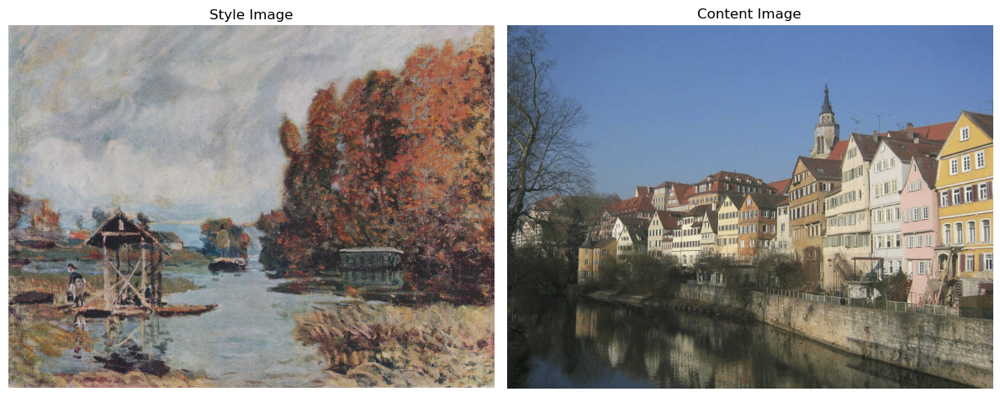

In [38]:
style_img, content_img = imgs
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(style_img)
axes[0].set_title('Style Image')
axes[0].axis('off')
axes[1].imshow(content_img)
axes[1].set_title('Content Image')
axes[1].axis('off')

plt.tight_layout()
plt.show()

# Image Style Transfer

## MSE Loss

In [9]:
#define layers, loss functions, weights and compute optimization targets
opt_img_mse = Variable(content_image.data.clone(), requires_grad=True)
style_layers = ['r11','r21','r31','r41', 'r51']
content_layers = ['r42']
loss_layers = style_layers + content_layers
loss_fns = [GramMSELoss()] * len(style_layers) + [nn.MSELoss()] * len(content_layers)
if torch.cuda.is_available():
    loss_fns = [loss_fn.cuda() for loss_fn in loss_fns]

#these are good weights settings:
style_weights = [1e3/n**2 for n in [64,128,256,512,512]]
content_weights = [1e0]
weights = style_weights + content_weights

#compute optimization targets
style_targets = [GramMatrix()(A).detach() for A in vgg(style_image, style_layers)]
content_targets = [A.detach() for A in vgg(content_image, content_layers)]
targets = style_targets + content_targets

In [10]:
#run style transfer
max_iter = 500
show_iter = 50
optimizer = optim.LBFGS([opt_img_mse])
n_iter=[0]

while n_iter[0] <= max_iter:

    def closure():
        optimizer.zero_grad()
        out = vgg(opt_img_mse, loss_layers)
        layer_losses = [weights[a] * loss_fns[a](A, targets[a]) for a,A in enumerate(out)]
        loss = torch.sum(torch.stack(layer_losses))
        loss.backward()
        n_iter[0]+=1
        #print loss
        if n_iter[0]%show_iter == (show_iter-1):
            print('Iteration: %d, loss: %f'%(n_iter[0]+1, loss.item()))
            print([f"{loss_layers[li]}: {l.item()}" for li, l in enumerate(layer_losses)])
        return loss

    optimizer.step(closure)

Iteration: 50, loss: 42987.660156
['r11: 3968.199951171875', 'r21: 8448.3701171875', 'r31: 907.361083984375', 'r41: 5928.25146484375', 'r51: 1.4443283081054688', 'r42: 23734.03125']
Iteration: 100, loss: 25448.076172
['r11: 334.93499755859375', 'r21: 1323.6680908203125', 'r31: 316.6364440917969', 'r41: 3053.85888671875', 'r51: 1.6102774143218994', 'r42: 20417.3671875']
Iteration: 150, loss: 21841.658203
['r11: 79.66315460205078', 'r21: 393.583251953125', 'r31: 178.99388122558594', 'r41: 2543.1015625', 'r51: 1.6722911596298218', 'r42: 18644.642578125']
Iteration: 200, loss: 20561.351562
['r11: 30.957061767578125', 'r21: 170.18994140625', 'r31: 135.77784729003906', 'r41: 2346.61376953125', 'r51: 1.7203705310821533', 'r42: 17876.091796875']
Iteration: 250, loss: 19927.111328
['r11: 17.508785247802734', 'r21: 107.72748565673828', 'r31: 113.66153717041016', 'r41: 2248.163818359375', 'r51: 1.7535300254821777', 'r42: 17438.296875']
Iteration: 300, loss: 19541.951172
['r11: 11.525147438049316'

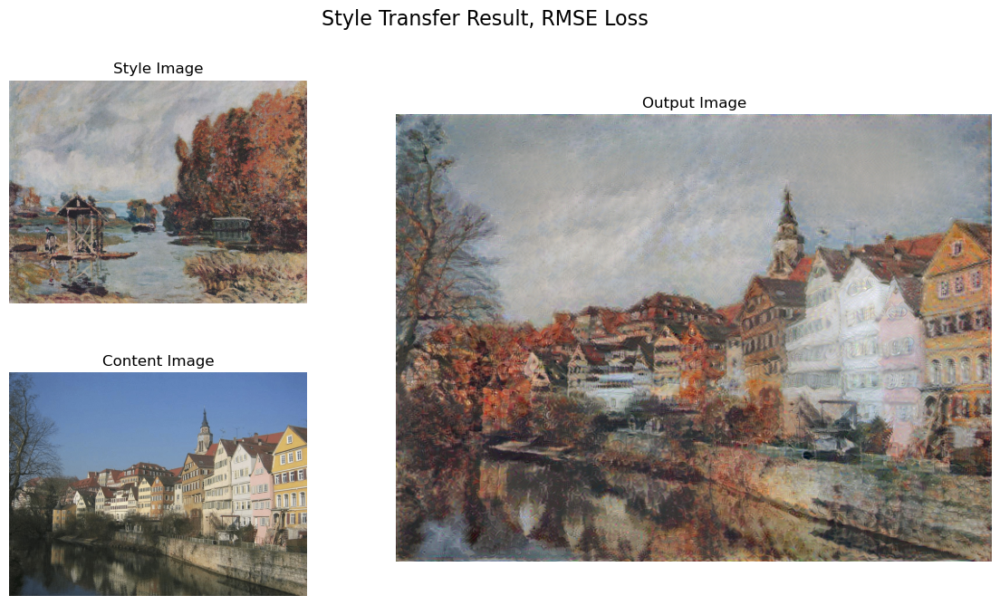

In [11]:
#display result
out_img_mse = postp(opt_img_mse.data[0].cpu().squeeze())

fig = plt.figure(figsize=(14, 8))
gs = GridSpec(2, 2, width_ratios=[1, 2], hspace=0.1, wspace=0.2)

ax1 = fig.add_subplot(gs[0, 0])
ax1.imshow(style_img)
ax1.set_title('Style Image')
ax1.axis('off')

ax2 = fig.add_subplot(gs[1, 0])
ax2.imshow(content_img)
ax2.set_title('Content Image')
ax2.axis('off')

ax3 = fig.add_subplot(gs[:, 1])
ax3.imshow(out_img_mse)
ax3.set_title('Output Image')
ax3.axis('off')
fig.suptitle('Style Transfer Result, RMSE Loss', fontsize=16, y=0.95)
plt.show()

## Pearson Loss

In [12]:
#define layers, loss functions, weights and compute optimization targets
opt_img_prs = Variable(content_image.data.clone(), requires_grad=True)
style_layers = ['r11','r21','r31','r41', 'r51']
content_layers = ['r42']
loss_layers = style_layers + content_layers
loss_fns = [PearsonCorrelationLoss()] * len(style_layers) + [nn.MSELoss()] * len(content_layers)
if torch.cuda.is_available():
    loss_fns = [loss_fn.cuda() for loss_fn in loss_fns]


style_weights = [1e7/n**2 for n in [64,128,256,512,512]]
content_weights = [1e-3]
weights = style_weights + content_weights

#compute optimization targets
style_targets = [GramMatrix()(A).detach() for A in vgg(style_image, style_layers)]
content_targets = [A.detach() for A in vgg(content_image, content_layers)]
targets = style_targets + content_targets

#run style transfer
max_iter = 500
show_iter = 50
optimizer = optim.LBFGS([opt_img_prs])
n_iter=[0]

while n_iter[0] <= max_iter:

    def closure():
        optimizer.zero_grad()
        out = vgg(opt_img_prs, loss_layers)
        layer_losses = [weights[a] * loss_fns[a](A, targets[a]) for a,A in enumerate(out)]
        loss = torch.sum(torch.stack(layer_losses))
        loss.backward()
        n_iter[0]+=1
        #print loss
        if n_iter[0]%show_iter == (show_iter-1):
            print('Iteration: %d, loss: %f'%(n_iter[0]+1, loss.item()))
            print([f"{loss_layers[li]}: {l.item()}" for li, l in enumerate(layer_losses)])
        return loss

    optimizer.step(closure)

Iteration: 50, loss: 17.598635
['r11: 0.21944287419319153', 'r21: 0.3772220313549042', 'r31: 0.9393807053565979', 'r41: 1.57177734375', 'r51: 2.148892641067505', 'r42: 12.3419189453125']
Iteration: 100, loss: 14.141050
['r11: 0.05587935447692871', 'r21: 0.13158568739891052', 'r31: 0.5816218852996826', 'r41: 1.4945749044418335', 'r51: 1.836417555809021', 'r42: 10.040970802307129']
Iteration: 150, loss: 13.514268
['r11: 0.03827153891324997', 'r21: 0.09189534187316895', 'r31: 0.5001129508018494', 'r41: 1.5036470890045166', 'r51: 1.7495653629302979', 'r42: 9.630775451660156']
Iteration: 200, loss: 13.275478
['r11: 0.03055902197957039', 'r21: 0.07825292646884918', 'r31: 0.4729645252227783', 'r41: 1.5206501483917236', 'r51: 1.722567081451416', 'r42: 9.450485229492188']
Iteration: 250, loss: 13.146910
['r11: 0.026193447411060333', 'r21: 0.07137714326381683', 'r31: 0.46067726612091064', 'r41: 1.5421687364578247', 'r51: 1.7097135782241821', 'r42: 9.336779594421387']
Iteration: 300, loss: 13.069

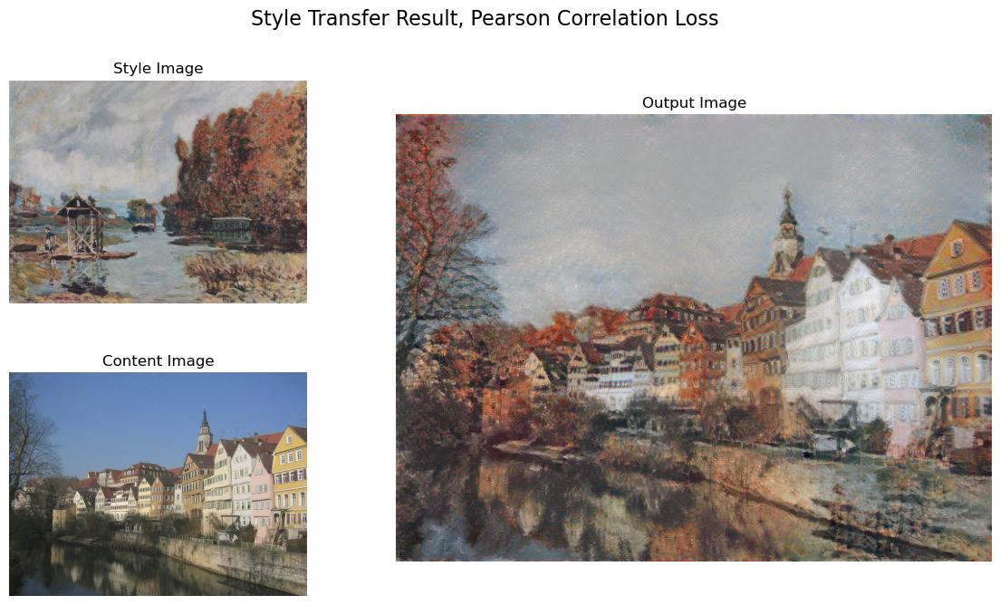

In [13]:
#display result
out_img_prs = postp(opt_img_prs.data[0].cpu().squeeze())

fig = plt.figure(figsize=(14, 8))
gs = GridSpec(2, 2, width_ratios=[1, 2], hspace=0.1, wspace=0.2)

ax1 = fig.add_subplot(gs[0, 0])
ax1.imshow(style_img)
ax1.set_title('Style Image')
ax1.axis('off')

ax2 = fig.add_subplot(gs[1, 0])
ax2.imshow(content_img)
ax2.set_title('Content Image')
ax2.axis('off')

ax3 = fig.add_subplot(gs[:, 1])
ax3.imshow(out_img_prs)
ax3.set_title('Output Image')
ax3.axis('off')
fig.suptitle('Style Transfer Result, Pearson Correlation Loss', fontsize=16, y=0.95)
plt.show()

## Cosine Loss

In [14]:
#define layers, loss functions, weights and compute optimization targets
opt_img_cos = Variable(content_image.data.clone(), requires_grad=True)
style_layers = ['r11','r21','r31','r41', 'r51']
content_layers = ['r42']
loss_layers = style_layers + content_layers
loss_fns = [CosineSimilarityLoss()] * len(style_layers) + [nn.MSELoss()] * len(content_layers)
if torch.cuda.is_available():
    loss_fns = [loss_fn.cuda() for loss_fn in loss_fns]


style_weights = [1e7/n**2 for n in [64,128,256,512,512]]
content_weights = [1e-3]
weights = style_weights + content_weights

#compute optimization targets
style_targets = [GramMatrix()(A).detach() for A in vgg(style_image, style_layers)]
content_targets = [A.detach() for A in vgg(content_image, content_layers)]
targets = style_targets + content_targets

#run style transfer
max_iter = 500
show_iter = 50
optimizer = optim.LBFGS([opt_img_cos])
n_iter=[0]

while n_iter[0] <= max_iter:

    def closure():
        optimizer.zero_grad()
        out = vgg(opt_img_cos, loss_layers)
        layer_losses = [weights[a] * loss_fns[a](A, targets[a]) for a,A in enumerate(out)]
        loss = torch.sum(torch.stack(layer_losses))
        loss.backward()
        n_iter[0]+=1
        #print loss
        if n_iter[0]%show_iter == (show_iter-1):
            print('Iteration: %d, loss: %f'%(n_iter[0]+1, loss.item()))
            print([f"{loss_layers[li]}: {l.item()}" for li, l in enumerate(layer_losses)])
        return loss

    optimizer.step(closure)

Iteration: 50, loss: 14.513168
['r11: 0.21173036098480225', 'r21: 0.24581822752952576', 'r31: 0.9027007818222046', 'r41: 1.540918231010437', 'r51: 1.8758169412612915', 'r42: 9.736184120178223']
Iteration: 100, loss: 12.095812
['r11: 0.06548361480236053', 'r21: 0.09873474389314651', 'r31: 0.6167192459106445', 'r41: 1.528540015220642', 'r51: 1.668558955192566', 'r42: 8.117775917053223']
Iteration: 150, loss: 11.606371
['r11: 0.04511093720793724', 'r21: 0.07301423698663712', 'r31: 0.543786883354187', 'r41: 1.5524165630340576', 'r51: 1.6226385831832886', 'r42: 7.769403457641602']
Iteration: 200, loss: 11.403766
['r11: 0.03608874976634979', 'r21: 0.06362824887037277', 'r31: 0.5197762250900269', 'r41: 1.5766658782958984', 'r51: 1.6037369966506958', 'r42: 7.603869438171387']
Iteration: 250, loss: 11.300287
['r11: 0.03215973079204559', 'r21: 0.060244929045438766', 'r31: 0.5094352960586548', 'r41: 1.598793864250183', 'r51: 1.5961768627166748', 'r42: 7.503477096557617']
Iteration: 300, loss: 11.

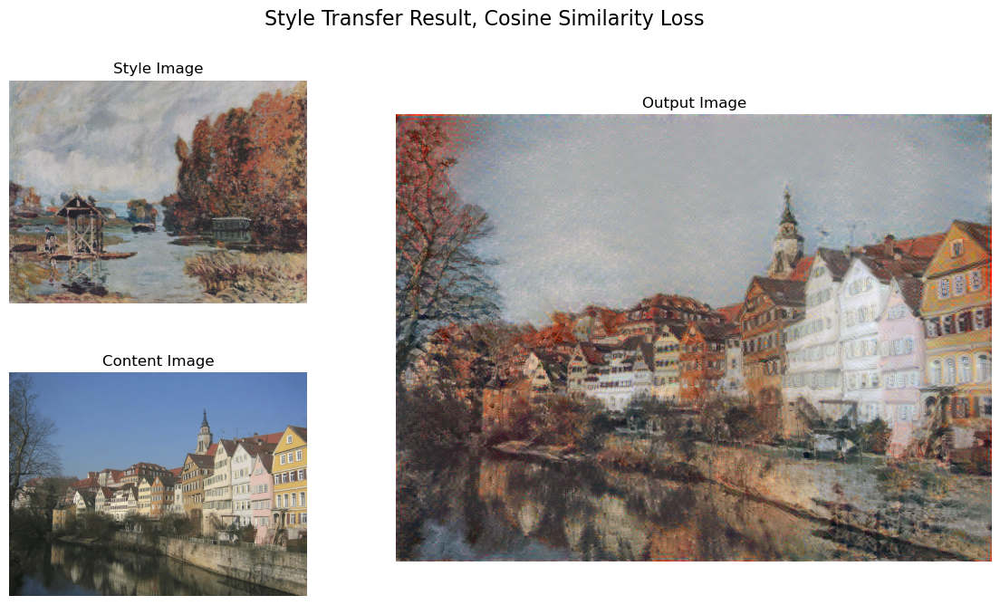

In [15]:
#display result
out_img_cos = postp(opt_img_cos.data[0].cpu().squeeze())

fig = plt.figure(figsize=(14, 8))
gs = GridSpec(2, 2, width_ratios=[1, 2], hspace=0.1, wspace=0.2)

ax1 = fig.add_subplot(gs[0, 0])
ax1.imshow(style_img)
ax1.set_title('Style Image')
ax1.axis('off')

ax2 = fig.add_subplot(gs[1, 0])
ax2.imshow(content_img)
ax2.set_title('Content Image')
ax2.axis('off')

ax3 = fig.add_subplot(gs[:, 1])
ax3.imshow(out_img_cos)
ax3.set_title('Output Image')
ax3.axis('off')
fig.suptitle('Style Transfer Result, Cosine Similarity Loss', fontsize=16, y=0.95)
plt.show()

# Comparison

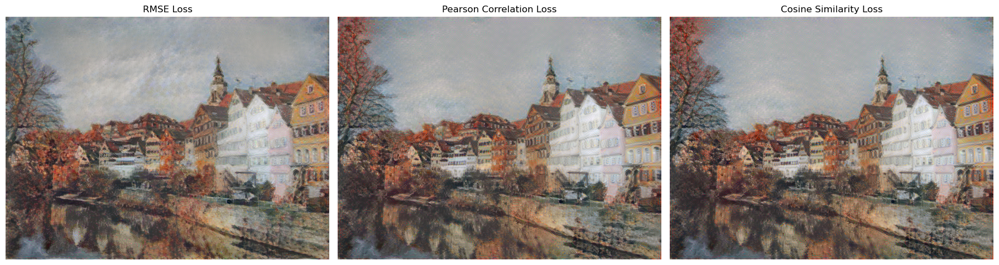

In [16]:
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(out_img_mse)
axes[0].set_title('RMSE Loss')
axes[0].axis('off')
axes[1].imshow(out_img_prs)
axes[1].set_title('Pearson Correlation Loss')
axes[1].axis('off')
axes[2].imshow(out_img_cos)
axes[2].set_title('Cosine Similarity Loss')
axes[2].axis('off')
plt.tight_layout()
plt.show()

# Preparing 12 images for each loss

In [40]:
def synthesizeImage(style_image, content_image, loss_fn, style_weights, content_weights, max_iter=500, show_iter=100):
    opt_img = Variable(content_image.data.clone(), requires_grad=True)
    style_layers = ['r11','r21','r31','r41', 'r51']
    content_layers = ['r42']
    loss_layers = style_layers + content_layers
    loss_fns = [loss_fn()] * len(style_layers) + [nn.MSELoss()] * len(content_layers)
    if torch.cuda.is_available():
        loss_fns = [loss_fn.cuda() for loss_fn in loss_fns]

    weights = style_weights + content_weights

    #compute optimization targets
    style_targets = [GramMatrix()(A).detach() for A in vgg(style_image, style_layers)]
    content_targets = [A.detach() for A in vgg(content_image, content_layers)]
    targets = style_targets + content_targets

    #run style transfer
    optimizer = optim.LBFGS([opt_img])
    n_iter=[0]

    while n_iter[0] <= max_iter:

        def closure():
            optimizer.zero_grad()
            out = vgg(opt_img, loss_layers)
            layer_losses = [weights[a] * loss_fns[a](A, targets[a]) for a,A in enumerate(out)]
            loss = torch.sum(torch.stack(layer_losses))
            loss.backward()
            n_iter[0]+=1
            if n_iter[0]%show_iter == (show_iter-1):
                print('Iteration: %d, loss: %f'%(n_iter[0]+1, loss.item()))
                #print([f"{loss_layers[li]}: {l.item()}" for li, l in enumerate(layer_losses)])
            return loss

        optimizer.step(closure)

    return postp(opt_img.data[0].cpu().squeeze())

In [28]:
#Image.open(str(image_path)+ "/" + "Baroque_0.jpg")

In [43]:
style_images = []

for style in top4styles:
    for i in range(3):
        style_images.append(Image.open(str(image_path) + "/" + f"{style}_{i}.jpg"))

style_images_torch = [prep(img) for img in style_images]

if torch.cuda.is_available():
    style_images_torch = [Variable(img.unsqueeze(0).cuda()) for img in style_images_torch]
else:
    style_images_torch = [Variable(img.unsqueeze(0)) for img in style_images_torch]


In [52]:
rmse_style_weights = [1e3/n**2 for n in [64,128,256,512,512]]
rmse_content_weights = [1e0]
prs_style_weights = [1e7/n**2 for n in [64,128,256,512,512]]
prs_content_weights = [1e-3]
cos_style_weights = [1e7/n**2 for n in [64,128,256,512,512]]
cos_content_weights = [1e-3]

rmse_out_img = []
prs_out_img = []
cos_out_img = []

i = 0
for style_image in style_images_torch:

    print(f"Processing Image {i+1}/{len(style_images_torch)}")
    i += 1
    
    print("Running RMSE Loss Synthesis...")
    rmse_out_img.append(synthesizeImage(style_image, content_image, GramMSELoss,
                                rmse_style_weights, rmse_content_weights,
                                max_iter=500, show_iter=100))

    print("Running Pearson Correlation Loss Synthesis...")
    prs_out_img.append(synthesizeImage(style_image, content_image, PearsonCorrelationLoss,
                                prs_style_weights, prs_content_weights,
                                max_iter=500, show_iter=100))

    print("Running Cosine Similarity Loss Synthesis...")
    cos_out_img.append(synthesizeImage(style_image, content_image, CosineSimilarityLoss,
                                cos_style_weights, cos_content_weights,
                                max_iter=500, show_iter=100))

Processing Image 1/12
Running RMSE Loss Synthesis...
Iteration: 100, loss: 25441.226562
Iteration: 200, loss: 20503.902344
Iteration: 300, loss: 19516.332031
Iteration: 400, loss: 19111.255859
Iteration: 500, loss: 18919.955078
Running Pearson Correlation Loss Synthesis...
Iteration: 100, loss: 14.155437
Iteration: 200, loss: 13.270964
Iteration: 300, loss: 13.065897
Iteration: 400, loss: 12.978194
Iteration: 500, loss: 12.930687
Running Cosine Similarity Loss Synthesis...
Iteration: 100, loss: 12.102693
Iteration: 200, loss: 11.413247
Iteration: 300, loss: 11.240398
Iteration: 400, loss: 11.168285
Iteration: 500, loss: 11.126225
Processing Image 2/12
Running RMSE Loss Synthesis...
Iteration: 100, loss: 33485.019531
Iteration: 200, loss: 29388.121094
Iteration: 300, loss: 28373.919922
Iteration: 400, loss: 27917.339844
Iteration: 500, loss: 27672.082031
Running Pearson Correlation Loss Synthesis...
Iteration: 100, loss: 16.682968
Iteration: 200, loss: 15.760639
Iteration: 300, loss: 15

## Save Locally

In [ ]:
# loss_to_imgs = {
#     "RMSE": rmse_out_img,
#     "PRS":  prs_out_img,
#     "COS":  cos_out_img,
# }

# root = Path("synth_out")
# root.mkdir(parents=True, exist_ok=True)

# for loss_name, img_list in loss_to_imgs.items():
#     for j, img in enumerate(img_list):
#         style = top4styles[(j // 3) % 4]
#         idx = j % 3
#         path = root / f"{loss_name}_{style}_{idx}.jpg"
#         (to_pil_image(img.clamp(0, 1)) if isinstance(img, torch.Tensor) else img).save(path)

## Read Pictures

In [ ]:
root = Path("synth_out")
top4styles = ["Impressionism", "Realism", "Baroque", "Romanticism"]

rmse_imgs, prs_imgs, cos_imgs = [], [], []

for style in top4styles:
    for i in range(3):
            rmse_imgs.append(Image.open(root / f"RMSE_{style}_{i}.jpg"))
                    prs_imgs.append(Image.open(root / f"PRS_{style}_{i}.jpg"))
                            cos_imgs.append(Image.open(root / f"COS_{style}_{i}.jpg"))
                            

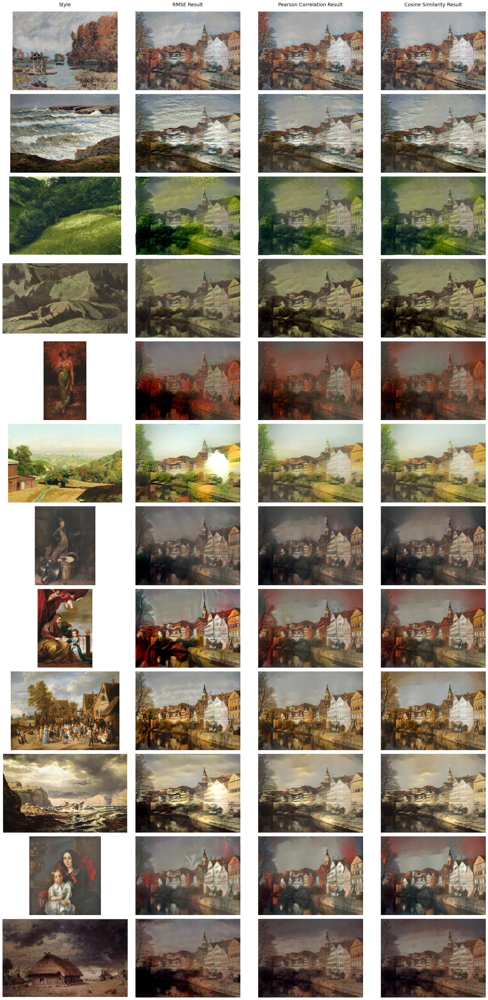

[<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1847x1382>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1922x1382>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1979x1382>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2456x1382>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1382x2541>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2002x1382>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1382x1800>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1382x1987>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1908x1382>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2180x1382>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1382x1523>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2218x1382>]

In [65]:
fig, axes = plt.subplots(nrows=12, ncols=4, figsize=(20, 40))
col_titles = ["Style", "RMSE Results", "Pearson Correlation Results", "Cosine Similarity Results"]

# add column titles once, centered above corresponding column
for c, title in enumerate(col_titles):
    axes[0, c].set_title(title, fontsize=14, pad=15)

# zip the four lists row-wise and plot
for r, (style_im, rmse_im, prs_im, cos_im) in enumerate(
        zip(style_images, rmse_imgs, prs_imgs, cos_imgs)):
    for c, im in enumerate([style_im, rmse_im, prs_im, cos_im]):
        axes[r, c].imshow(im)
        axes[r, c].axis("off")

plt.tight_layout()
plt.show()
style_images